# How Income Levels Impact the Risk of Developing Diabetes

In [1]:
# Import packages
import pandas as pd
import plotly.express as px
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib.ticker import PercentFormatter
import warnings
warnings.filterwarnings('ignore')

## Introduction

Diabetes is a chronic disease that impacts millions of people. The body cannot properly regulate glucose, which can lead to high blood sugar levels and, if untreated, damage to various organs.

Diabetes occurs in two forms: type 1 and type 2. In this data story, we primarily focus on type 2 diabetes because correlations can be found between factors such as lifestyle, diet, and health. These factors influence the onset of type 2 diabetes, unlike type 1 diabetes, which is mainly genetically determined. By examining how physical activity and environmental factors contribute to this condition among people with different incomes, we can determine whether there is a higher or lower risk of developing type 2 diabetes among different income groups.

Through this data story, we aim to shed light on this issue so that more effective prevention and treatment strategies can be developed to improve the quality of life for financially vulnerable people with diabetes.

Here are following perspective and arguments:

### Perspective 1: Having a low source of income increases your chances on diabetes
Household income is closely linked to diabetes prevalence and management. Healthy food options, often more expensive, can be unaffordable for lower-income households, leading to poor dietary choices that increase diabetes risk. Additionally, people in lower-income brackets may have less access to safe spaces for physical activity, contributing to sedentary lifestyles and higher obesity rates, both risk factors for diabetes. Financial constraints also limit access to healthcare, diabetes education, and essential medical supplies. Thus, the economic disparities directly influence the ability to prevent and manage diabetes effectively, exacerbating health inequalities.

In our study, we examined the relationship between household income and diabetes rates, finding a clear correlation where lower-income households exhibited higher diabetes prevalence. We analyzed dietary patterns and found that these households often resort to cheaper, unhealthy food options due to financial constraints, which contribute to increased diabetes risk. Additionally, we investigated physical activity levels across different income groups. Our findings revealed that lower-income households tend to have lower physical activity levels, often due to a lack of access to safe and affordable exercise facilities, further increasing their diabetes rates. This dual analysis underscores the impact of economic disparities on diabetes prevalence and highlights the need for targeted interventions.

#### Countries with a lower GDP generally have a higher prevalence of diabetes


#### Households with lower income are further away from healthy stores or stores with lots of variety

Households with lower incomes are further away from stores that sell unprocessed goods such as fishmarkets and farmermarkets. They are further away from Super stores, Large grocery stores and delivery routes are also further away which are usually the places people can get a large variety of food.
Small convenience store, butchers and vendors of fruit and vegetables are usually closer by. 

This means that poorer households have less variety in their meals which can cause problems.

Convenience stores and small grocery stores typically stock processed foods, which are often high in sugars, fats, and calories. This diet pattern contributes to obesity and therefore diabetes. 

The availability of low-cost, energy-dense foods makes them an attractive option for low-income households, further contributing to poor dietary habits and diabetes.


#### Individuals with a lower income do less physical activity outside of work
We investigated the relationship between household income and physical activity levels to understand how economic status influences lifestyle choices and health outcomes. Given that physical inactivity is a significant risk factor for developing diabetes, understanding these patterns can help us identify vulnerable populations.

### Perspective 2: Having a low income does not cause higher chance of diabetes.
#### Exercising doesn't have to cost money


## Perspective 1
We used the parallel coordinates plot graph to distinguish the relationships between significant factors that have an impact on the risk of getting diabetes. We looked at the BMI, physical activity, vegetable consumption, healthcare access and income. The Income is distributed into 8 different bins ranging from 1 to 8 (low to high income). Furthermore the diabetic status is represented by the yellow lines and the non-diabetic status is indicated by the blue lines . Throughout the entire plot you can see the values 0.0 and 1.0, with 0.0 indicating ‘no’ and 0.1 indicating ‘yes’.

Looking at the lines indicated between physical activity and the diabetic status, we can assess that diabetic individuals are more likely to be inactive in contrast to non-diabetic individuals which are more evenly spread across active and inactive categories. This shows that physical activity plays a major role in the prevention of diabetes. Vegetable consumption illustrates this trend aswell as the yellow lines aren’t as evenly spread as the blue lines for diabetic individuals. This affirmes the fact that eating healthy food has a positive impact on the prevention of diabetes. However, there doesn’t seem to be a big difference in trends for diabetics or non-diabetics if they have access to healthcare or not. This is probably not the case for individuals in developing countries as the low quality of healthcare there, combined with the lack of food, could have detrimental consequences to an individual's health. Lastly, you can see that the income levels show an increasing growth in the yellow bars (diabetic individuals) as the income becomes lower. This suggests that lower income is associated with a higher risk of diabetes, likely due to factors such as limited access to nutritious food and opportunities for physical activity.


In [13]:
df = pd.read_csv("diabetes_split.csv")

#Define the number of bins
num_bins_bmi = 5
num_bins_income = 8

#Bin BMI values
df['BMI_category'] = pd.qcut(df['BMI'], q=num_bins_bmi, labels=False, precision=0, duplicates='drop')
bmi_labels = ['Underweight', 'Normal weight', 'Overweight', 'Moderately obese', 'Severely obese']
df['BMI_category'] = df['BMI_category'].map(lambda x: bmi_labels[int(x)] if not pd.isnull(x) else 'Unknown')

#Manually set bin edges for Income to ensure all categories are included
income_min = df['Income'].min()
income_max = df['Income'].max()
income_bin_edges = pd.cut(df['Income'], bins=num_bins_income, retbins=True, include_lowest=True, labels=False)[1]
income_bin_edges[-1] = income_max + 1  # Ensure the last bin edge includes the maximum value

#Assign income categories
df['Income'] = pd.cut(df['Income'], bins=income_bin_edges, labels=range(num_bins_income), include_lowest=True)
income_labels = ['1', '2', '3', '4', '5', '6', '7', '8']
df['Income'] = df['Income'].map(lambda x: income_labels[int(x)] if not pd.isnull(x) else 'Unknown')

#Create the parallel categories plot
fig_1 = go.Figure(data=go.Parcats(
    dimensions=[
        {'label': 'Diabetes', 'values': df['Diabetes_binary'].astype(str)},
        {'label': 'BMI', 'values': df['BMI_category']}, 
        {'label': 'Physical Activity', 'values': df['PhysActivity'].astype(str)},
        {'label': 'Vegetables', 'values': df['Veggies'].astype(str)},
        {'label': 'Any Healthcare', 'values': df['AnyHealthcare'].astype(str)},
        {'label': 'Income', 'values': df['Income'], 'categoryorder': 'array', 'categoryarray': income_labels},
    ],
    line={'color': df['Diabetes_binary'], 'colorscale': [[0, 'yellow'], [1.0, 'red']]}
))

fig_1.update_layout(title='Analysis of Diabetes Data across Various Factors')
fig_1.show()

### Countries with a lower GDP generally have a higher prevalence of diabetes

In [12]:
import plotly.express as px
import pandas as pd

gdp = pd.read_csv('API_NY.GDP.PCAP.CD_DS2_en_csv_v2_637318.csv')
gdp = gdp[['Country Name', '2000', '2011', '2021']]
gdp = pd.melt(gdp, id_vars='Country Name', var_name='Year', value_name='GDP')
gdp['Year'] = gdp['Year'].astype('int64') 

diab_prev = pd.read_csv('diabetes-prevalence.csv')

diab_prev['Year'] = pd.to_numeric(diab_prev['Year'])

merged = pd.merge(diab_prev, gdp, left_on=['Entity', 'Year'], right_on=['Country Name', 'Year'], how='inner')
merged.drop('Country Name', axis=1, inplace=True)
merged = merged.sort_values(by='Year')
merged = merged.rename(columns={'Diabetes prevalence (% of population ages 20 to 79)': 'Diabetes %'})

min_val = merged['Diabetes %'].min()
max_val = merged['Diabetes %'].max()

color_scale = px.colors.sequential.YlOrRd

fig = px.choropleth(merged, 
                    locations='Code',
                    color='Diabetes %',
                    hover_name='Entity',
                    hover_data={'Code': False, 'Diabetes %': ':.1f', 'GDP': True, 'Year' : False},
                    animation_frame='Year',
                    range_color=(min_val, max_val), 
                    color_continuous_scale=color_scale,
                    projection='natural earth'
                   )

fig.update_layout(title='Diabetes Prevalence Worldwide and Gdp per country',
                  geo=dict(showcoastlines=True,
                           showcountries=True),
                  height=600,
                  width=1000
                 )

fig.show()

In [4]:
df4 = pd.read_csv("weight_20_USA.csv")
df5 = pd.read_csv("Weight_children_USA.csv")
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

### People with a lower income have less access to healthy food because healthy food is more expensive.

In [5]:
try:
    df7 = pd.read_csv("faps_access_puf.csv", encoding='latin-1')
    df8 = pd.read_csv("faps_fahitem_puf.csv", encoding='latin-1')
    df9 = pd.read_csv("faps_fafhitem_puf.csv", encoding='latin-1')
except UnicodeDecodeError as e:
    print(f"UnicodeDecodeError: {e}")

#### Which macronutriens are unhealty?

Fats:

Fats consist of 3 main types; saturated fats, which can usually be found in dairy products, monounsaturated fats which can be found in nuts, seeds and oils, and polyunsaturated fats, which can be found in falxseeds, walnuts and fish. 

Since saturated fats take less time to be stored or processed due to their relative simplicity and their tendency to raise LDL cholesterol (low-density lipoprotein), which can increase the risk of cardiovascular disease by clogging the arteries, they are generally regarded as the worst kind of fat.

Less than 5-6% of daily calorie intake should be saturated fat which is about 11-13 grams a day if you account for a 2000 kcal diet, so about 120 kcal. (Saturated Fat, 2024)


Carbohydrates:

Carbs consist of 3 main types; Sugars, Starches and Fibers. 

Sugars are incomplex carbohydrates such as mono- and disaccharides which can be easily converted into glucose (which is a monosaccharid) and can then either be converted into fat for storage or be consumed for energy, an acces causes insulin to be released in the pancreas and convert these monosaccharides into fats. (Holesh et al., 2023)

Starches are longer chains of saccharides, they can be found in starchy foods such as beans and potatoes, these polysaccharides take longer to be converted into glucose so they provide sugars in a slower tempo and keep you filled for quite some time. So they are regarded as a healthy carbs.

Fibers promote gut health and are not digested because they are too complex. animals with multiple stomachs such as cows do eat these as a source of carbs.

Generally people shouldn't consume more than 30 grams or about 125 kcal of monosaccharides per day. (How Much Sugar Is Too Much?, 2024)

We will use these macronutriens to measure if a certain food is healthy or not. If a fooditem has more than 1/2 of the daily recommended intake of either sugars or saturated fat, or if the total amount of carbs per fooditem consists of more than 11.5% sugar it will be regarded as unhealthy. Fatty food will be regarded unhealthy if more than 19.5% of the total fat is saturated fat.

Since some foods have low amounts of sugar and fats but they are of the unhealthy kind, such as onions which have 0.042 grams of saturated fat we'll add a minimum weight percentage of 30% fat or sugar.

This data is gathered from SNAP households, SNAP is a welfare program in the US for people with low incomes.

#### Results
The graph provides insights into the dietary habits of low-income individuals utilizing SNAP (Supplemental Nutrition Assistance Program) coupons. The left graph shows a significant disparity between the consumption of unhealthy foods (97,167 counts) versus healthy foods (45,883 counts), indicating that SNAP recipients are more likely to purchase unhealthy options. The right graph highlights the primary reasons for foods being classified as unhealthy: the predominant factor is sugar content exceeding 30% of total carbohydrates (75,347 counts), followed by saturated fat exceeding 30% of total fat (48,398 counts). High sugar and high saturated fat content also contribute significantly. Given households participating in the snap program are low-income shows us that low-income house-holds are more likely to consume unhealthy foods and thus they are at an increased risk for diabetes, underscoring the need for more accessible healthy food options and better nutritional guidance within the program.

Income scale scale 1-8; 1 <=  $10,000 5 <= $35,000 8 >= $75,000
13-level age category; 1 = 18-24 9 = 60-64 13 = 80 or older, these scales are linear

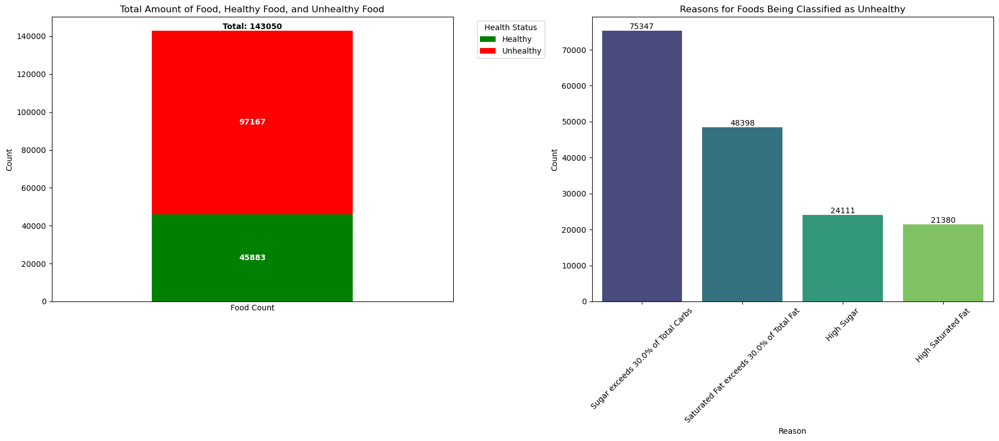

In [6]:
df10 = pd.read_csv("fah_nutrients_c.csv")

# Set the limits and thresholds
daily_sugar_limit = 30  # grams
daily_satfat_limit = 13  # grams
daily_calories = 2000  # kcal

sugar_threshold = daily_sugar_limit / 2
satfat_threshold = daily_satfat_limit / 2
carb_sugar_percentage_threshold = 11.5 / 100
fat_satfat_percentage_threshold = 42 / 100
min_satfat_percentage_of_total = 30 / 100
min_sugar_percentage_of_total = 30 / 100

# Function to classify foods
def classify_food(row):
    reasons = []
    
    if row['totsug'] > sugar_threshold:
        reasons.append('High Sugar')
        
    if row['carb'] != 0:
        sugar_percentage = (row['totsug'] / row['carb']) * 100
    else:
        sugar_percentage = 0
    
    if sugar_percentage > min_sugar_percentage_of_total * 100:
        reasons.append(f'Sugar exceeds {min_sugar_percentage_of_total * 100}% of Total Carbs')
        
    if row['satfat'] > satfat_threshold:
        reasons.append('High Saturated Fat')
        
    if row['totfat'] != 0:
        satfat_percentage = (row['satfat'] / row['totfat']) * 100
    else:
        satfat_percentage = 0
    
    if satfat_percentage > min_satfat_percentage_of_total * 100:
        reasons.append(f'Saturated Fat exceeds {min_satfat_percentage_of_total * 100}% of Total Fat')
    
    if reasons:
        return 'Unhealthy', reasons
    else:
        return 'Healthy', []

df10['Health_Status'], df10['Reasons'] = zip(*df10.apply(classify_food, axis=1))

# Calculate the counts
health_counts = df10['Health_Status'].value_counts()
total_count = df10.shape[0]
healthy_count = health_counts.get('Healthy', 0)
unhealthy_count = health_counts.get('Unhealthy', 0)

# Prepare data for stacked bar plot
plot_data = pd.DataFrame({
    'Healthy': [healthy_count],
    'Unhealthy': [unhealthy_count]
})

# Plot
fig, axs = plt.subplots(1, 2, figsize=(18, 8))

# Plot 1: Stacked bar plot for healthy and unhealthy food counts
plot_data.plot(kind='bar', stacked=True, color=['green', 'red'], ax=axs[0])
axs[0].set_title('Total Amount of Food, Healthy Food, and Unhealthy Food')
axs[0].set_xlabel('Food Count')
axs[0].set_ylabel('Count')
axs[0].set_xticks([])  # Remove x-ticks as there is only one bar
axs[0].legend(title='Health Status', bbox_to_anchor=(1.05, 1), loc='upper left')

# Add annotations for counts
axs[0].text(0, healthy_count / 2, str(healthy_count), ha='center', va='center', color='white', weight='bold')
axs[0].text(0, healthy_count + unhealthy_count / 2, str(unhealthy_count), ha='center', va='center', color='white', weight='bold')
axs[0].text(0, (healthy_count + unhealthy_count) + 5, f'Total: {total_count}', ha='center', va='bottom', weight='bold')

# Plot 2: Reasons for Foods Being Classified as Unhealthy
unhealthy_reasons = df10[df10['Health_Status'] == 'Unhealthy']['Reasons'].explode().value_counts()
sns.barplot(x=unhealthy_reasons.index, y=unhealthy_reasons.values, palette='viridis', ax=axs[1])
axs[1].set_title('Reasons for Foods Being Classified as Unhealthy')
axs[1].set_xlabel('Reason')
axs[1].set_ylabel('Count')
axs[1].tick_params(axis='x', rotation=45)
for index, value in enumerate(unhealthy_reasons.values):
    axs[1].text(index, value + 5, str(value), ha='center', va='bottom')

plt.tight_layout()
plt.show()

### People with lower incomes do less physical activity outside of work

The bubble plots illustrate a clear disparity in physical activity levels across different income groups. The top graph shows that higher-income households are more likely to engage in physical activity, as indicated by the larger bubbles in higher income brackets. Conversely, the bottom graph reveals that lower-income households exhibit higher rates of physical inactivity, with larger bubbles representing no physical activity predominantly in the lower income brackets. These findings highlight the disparity between income groups and age. It might be that because higher income jobs usually have less physical activity present in the nature of their work that they need physical activity to stay in shape, or it might be that people in lower income brackets simply have less time to do physical activity outside of work. This lack of activity leads to a higher chance of obesity, and thus diabetes.

In [7]:
df6 = pd.read_csv('diabetes_split.csv')

In [8]:
df6['PhysActivity'] = df6['PhysActivity'].astype(int)

# Map the values to their respective labels
df6['PhysActivity'] = df6['PhysActivity'].map({0: 'No Physical Activity', 1: 'Physical Activity'})

# Fill NaN values in PhysActivity column with a placeholder (if any)
df6['PhysActivity'] = df6['PhysActivity'].fillna('Unknown')

# Filter DataFrame for PhysActivity == 'Physical Activity' (1) and PhysActivity == 'No Physical Activity' (0)
df_active = df6[df6['PhysActivity'] == 'Physical Activity']
df_inactive = df6[df6['PhysActivity'] == 'No Physical Activity']

# Calculate proportions within the DataFrame for each subset
df_active['Proportion'] = df_active.groupby(['Age', 'Income'])['PhysActivity'].transform('size') / len(df_active)
df_inactive['Proportion'] = df_inactive.groupby(['Age', 'Income'])['PhysActivity'].transform('size') / len(df_inactive)

# Create Bubble Plot for Physical Activity
fig1 = px.scatter(
    df_active,
    x='Age',
    y='Income',
    size='Proportion',
    color='PhysActivity',
    hover_name='PhysActivity',
    size_max=30,
    title='Bubble Plot: Income by Age and Physical Activity (Physical Activity)',
    labels={
        'Age': 'Age',
        'Income': 'Income',
        'Proportion': 'Proportion of Total Values',
        'PhysActivity': 'Physical Activity'
    },
    template='plotly_white'
)

fig1.update_layout(
    xaxis=dict(
        title='Age',
        tickvals=list(range(1, 14)),
        ticktext=list(range(1, 14))
    ),
    yaxis=dict(
        title='Income',
        tickvals=list(range(1, 9)),
        ticktext=list(range(1, 9))
    ),
    height=600
)

# Create Bubble Plot for No Physical Activity
fig2 = px.scatter(
    df_inactive,
    x='Age',
    y='Income',
    size='Proportion',
    color='PhysActivity',
    hover_name='PhysActivity',
    size_max=30,
    title='Bubble Plot: Income by Age and Physical Activity (No Physical Activity)',
    labels={
        'Age': 'Age',
        'Income': 'Income',
        'Proportion': 'Proportion of Total Values',
        'PhysActivity': 'Physical Activity'
    },
    template='plotly_white'
)

fig2.update_layout(
    xaxis=dict(
        title='Age',
        tickvals=list(range(1, 14)),
        ticktext=list(range(1, 14))
    ),
    yaxis=dict(
        title='Income',
        tickvals=list(range(1, 9)),
        ticktext=list(range(1, 9))
    ),
    height=600
)

# Show the figures
fig1.show()
fig2.show()

### Healthy supermarkets are generally located further from poor neighborhoods, which means that people have less access to healthy food.

Households with lower incomes are further away from stores that sell unprocessed goods such as fishmarkets and farmermarkets, and are further away from Super stores, Large grocery stores and delivery routes are also further away which are usually the places people can get a large variety of food.
Small convenience store, butchers and vendors of fruit and vegetables are usually closer by. 

This means that poorer households have less variety in their meals which can cause problems.

Convenience stores and small grocery stores typically stock processed foods, which are often high in sugars, fats, and calories. This diet pattern contributes to obesity and therefore diabetes. 

The availability of low-cost, energy-dense foods makes them an attractive option for low-income households, further contributing to poor dietary habits and diabetes.


In [9]:
df11 = pd.read_csv('access_food_real_w_income.csv')

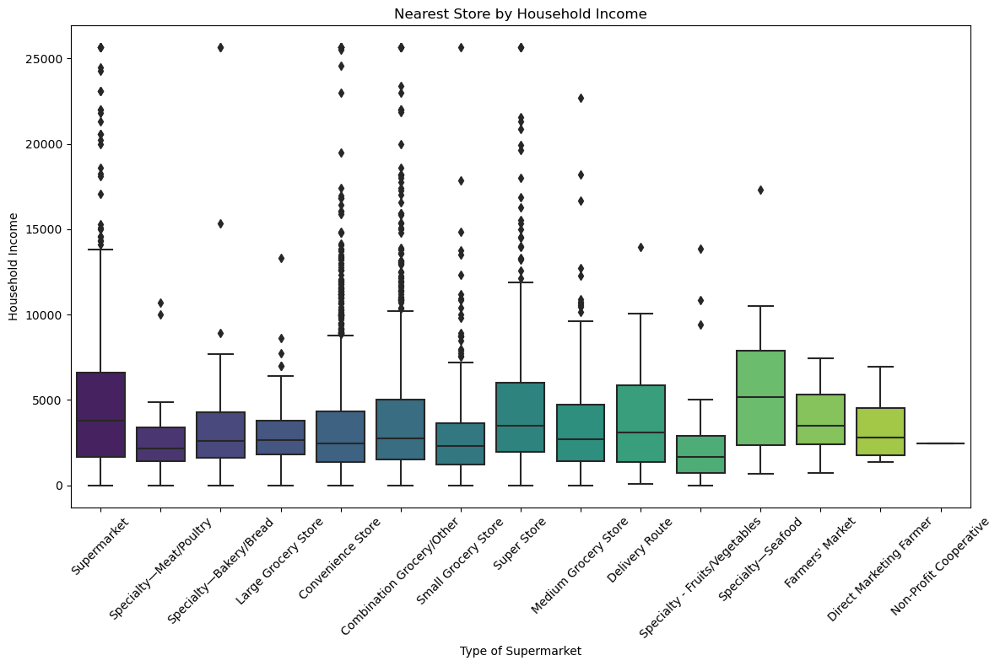

In [10]:
nearsnap_stype_mapping = {
    'BB': 'Specialty—Bakery/Bread',
    'BC': 'Non-Profit Cooperative',
    'CO': 'Combination Grocery/Other',
    'CS': 'Convenience Store',
    'DF': 'Direct Marketing Farmer',
    'DR': 'Delivery Route',
    'FM': "Farmers' Market",
    'FV': 'Specialty - Fruits/Vegetables',
    'LG': 'Large Grocery Store',
    'ME': 'Specialty—Meat/Poultry',
    'MG': 'Medium Grocery Store',
    'SE': 'Specialty—Seafood',
    'SG': 'Small Grocery Store',
    'SM': 'Supermarket',
    'SS': 'Super Store'
}

# Map full names to the nearsnap_stype column
df11['nearsnap_stype'] = df11['nearsnap_stype'].map(nearsnap_stype_mapping)

# Plotting the data
plt.figure(figsize=(12, 8))
sns.boxplot(x='nearsnap_stype', y='inchhavg_r', data=df11, palette='viridis')

# Customize labels and title
plt.xlabel('Type of Supermarket')
plt.ylabel('Household Income')
plt.title('Nearest Store by Household Income')

# Rotate x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Show plot
plt.tight_layout()
plt.show()

## Perspective 2: Having a low income does not cause higher chance of diabetes.

### Exercising doesn't have to cost money

Engaging in physical activities and sports doesn't always require expensive gym memberships or specialized equipment. Many forms of exercise, such as walking, jogging, running, and bodyweight exercises, are entirely free and can be done in public spaces like parks and community centers by using your own body weight. Additionally, community sports leagues, free fitness classes, and public recreational facilities offer opportunities for people of all income levels to participate in physical activity. Encouraging the use of these free resources can help lower-income individuals maintain an active lifestyle, thereby reducing the risk of health issues such as diabetes.

This graph shows that you can exercise for free, they are even quite effective. Someone who weighs 205 pounds loses more than 900 kcal when running 6 miles. The rate that someone burns 

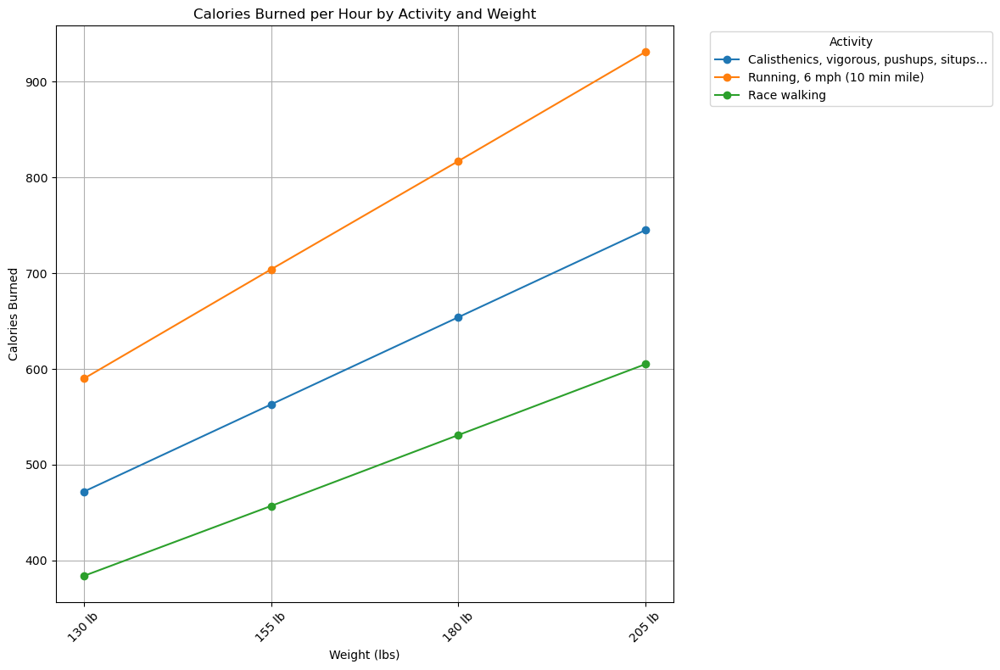

In [11]:
datasport = pd.read_csv('exercise.csv')

# Create a DataFrame
df = pd.DataFrame(datasport)

# Define the list of activities to filter and the desired columns
activities = ["Calisthenics, vigorous, pushups, situps…", "Running, 6 mph (10 min mile)", 'Race walking']
desired_col = ["130 lb", "155 lb", "180 lb", "205 lb"]

# Filter the DataFrame to include only the specified activities
filtered_df = df[df["Activity, Exercise or Sport (1 hour)"].isin(activities)]

# Set the index to the activity column
filtered_df.set_index("Activity, Exercise or Sport (1 hour)", inplace=True)

# Select the desired columns
filtered_df2 = filtered_df[desired_col]

# Transpose the filtered DataFrame for easier plotting
df_transposed = filtered_df2.T

# Plot the data
plt.figure(figsize=(12, 8))
for column in df_transposed.columns:
    plt.plot(df_transposed.index, df_transposed[column], marker='o', label=column)

plt.xlabel('Weight (lbs)')
plt.ylabel('Calories Burned')
plt.title('Calories Burned per Hour by Activity and Weight')
plt.legend(title='Activity', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

## Reflection
Van onze TA en medestudenten uit groep M kregen we feedback op onze draft tijdens een werkcollege 2 weken geleden. Wij presenteerden eerst ons werk, en kregen vervolgens feedback op de layout, visualisaties en argumenten. Hieronder staan de tips en feedback die wij hebben gekregen en ook gebruikt bij het schrijven van onze eindversie van de datastory:

-De layout en het lettertype aanpassen om de datastory visueel prettig te maken.
-Meer tekst schrijven bij de visualisaties.
-

Verder hebben we nagedacht over xxxxxx


## References

Calories Burned During Exercise and Activities. (2020, 5 juli). Kaggle. https://www.kaggle.com/datasets/aadhavvignesh/calories-burned-during-exercise-and-activities?resource=download

Data.gov. (2023, 29 augustus). U.S. Department of Health & Human Services - Normal weight, overweight, and obesity among adults aged 20 and over, by selected characteristics: United States. https://catalog.data.gov/dataset/normal-weight-overweight-and-obesity-among-adults-aged-20-and-over-by-selected-characteris-8e2b1 

-Diabetes Health Indicators Dataset. (2021, 8 november). Kaggle. https://www.kaggle.com/datasets/alexteboul/diabetes-health-indicators-dataset?select=diabetes_binary_health_indicators_BRFSS2015.csv 

-Diabetes.csV. (2017, 13 november). Kaggle. https://www.kaggle.com/datasets/saurabh00007/diabetescsv 

Holesh, J. E., Aslam, S., & Martin, A. (2023, 12 mei). Physiology, carbohydrates. StatPearls - NCBI Bookshelf. https://www.ncbi.nlm.nih.gov/books/NBK459280/ 

How much sugar is too much? (2024, 23 mei). www.heart.org. https://www.heart.org/en/healthy-living/healthy-eating/eat-smart/sugar/how-much-sugar-is-too-much 

Saturated fat. (2024, 8 april). www.heart.org. https://www.heart.org/en/healthy-living/healthy-eating/eat-smart/fats/saturated-fats USDA ERS - FoodAPS 

National Household Food Acquisition and Purchase Survey. (z.d.). https://www.ers.usda.gov/data-products/foodaps-national-household-food-acquisition-and-purchase-survey/ 

World Bank Open Data. (z.d.). World Bank Open Data. https://data.worldbank.org/indicator/NY.GDP.MKTP.CD

